In [ ]:
# import the necessary packages
from scipy.spatial import distance as dist
from collections import OrderedDict
import numpy as np 


class CentroidTracker():
	def __init__(self, maxDisappeared=50):
		# initialize the next unique object ID along with two ordered
		# dictionaries used to keep track of mapping a given object
		# ID to its centroid and number of consecutive frames it has
		# been marked as "disappeared", respectively
		self.nextid = 0
		self.objects = OrderedDict()
		self.disappeared = OrderedDict()
		# store the number of maximum consecutive frames a given object is allowed to be marked as "disappeared" until we
		# need to deregister the object from tracking
		self.maxDisappeared = maxDisappeared

	def register(self, centroid):
		# when registering an object we use the next available object ID to store the centroid
		self.objects[self.nextid] = centroid
		self.disappeared[self.nextid] = 0
		self.nextid += 1

	def deregister(self, objectID):
		# to deregister an object ID we delete the object ID from both of our respective dictionaries
		del self.objects[objectID]
		del self.disappeared[objectID]

	def update(self, rects):
		# check to see if the list of input bounding box rectangles
		# is empty
		if len(rects) == 0:
			# loop over any existing tracked objects and mark them
			# as disappeared
			for objectID in list(self.disappeared.keys()):
				self.disappeared[objectID] += 1
				# if we have reached a maximum number of consecutive
				# frames where a given object has been marked as
				# missing, deregister it
				if self.disappeared[objectID] > self.maxDisappeared:
					self.deregister(objectID)
			# return early as there are no centroids or tracking info
			# to update
			return self.objects
    
		# initialize an array of input centroids for the current frame
		centroids = np.zeros((len(rects), 2), dtype="int")
		# loop over the bounding box rectangles
		for (i, (ymin, xmin, ymax, xmax)) in enumerate(rects):
			# use the bounding box coordinates to derive the centroid
			cx = int((xmin + xmax) / 2.0)
			cy = int((ymin + ymax) / 2.0)
			centroids[i] = (cx, cy)
   
		# if we are currently not tracking any objects take the input
		# centroids and register each of them
		if len(self.objects) == 0:
			for i in range(0, len(centroids)):
				self.register(centroids[i])

		# otherwise, we are currently tracking objects so we need to
		# match the input centroids to existing object centroids
		else:
			# grab the set of object IDs and corresponding centroids
			obj_ids = list(self.objects.keys())
			obj_centroids = list(self.objects.values())
			# compute the distance between each pair of object
			# centroids and input centroids, respectively -- our
			# goal will be to match an input centroid to an existing
			# object centroid
			D = dist.cdist(np.array(obj_centroids), centroids)
			# in order to perform this matching we must (1) find the
			# smallest value in each row and then (2) sort the row
			# indexes based on their minimum values so that the row
			# with the smallest value is at the *front* of the index
			# list
			rows = D.min(axis=1).argsort()
			# next, we perform a similar process on the columns by
			# finding the smallest value in each column and then
			# sorting using the previously computed row index list
			cols = D.argmin(axis=1)[rows]
 
			# in order to determine if we need to update, register,
			# or deregister an object we need to keep track of which
			# of the rows and column indexes we have already examined
			usedRows = set()
			usedCols = set()
			# loop over the combination of the (row, column) index
			# tuples
			for (row, col) in zip(rows, cols):
				# if we have already examined either the row or
				# column value before, ignore it
				# val
				if row in usedRows or col in usedCols:
					continue
				# otherwise, grab the object ID for the current row,
				# set its new centroid, and reset the disappeared
				# counter
				objectID = obj_ids[row]
				self.objects[objectID] = centroids[col]
				self.disappeared[objectID] = 0
				# indicate that we have examined each of the row and
				# column indexes, respectively
				usedRows.add(row)
				usedCols.add(col)
 			# compute both the row and column index we have NOT yet
			# examined
			unusedRows = set(range(0, D.shape[0])).difference(usedRows)
			unusedCols = set(range(0, D.shape[1])).difference(usedCols)
			# in the event that the number of object centroids is
			# equal or greater than the number of input centroids
			# we need to check and see if some of these objects have
			# potentially disappeared
			if D.shape[0] >= D.shape[1]:
				# loop over the unused row indexes
				for row in unusedRows:
					# grab the object ID for the corresponding row
					# index and increment the disappeared counter
					objectID = obj_ids[row]
					self.disappeared[objectID] += 1
					# check to see if the number of consecutive
					# frames the object has been marked "disappeared"
					# for warrants deregistering the object
					if self.disappeared[objectID] > self.maxDisappeared:
						self.deregister(objectID)    
			# otherwise, if the number of input centroids is greater
			# than the number of existing object centroids we need to
			# register each new input centroid as a trackable object
			else:
				for col in unusedCols:
					self.register(centroids[col])
		# return the set of trackable objects
		return self.objects

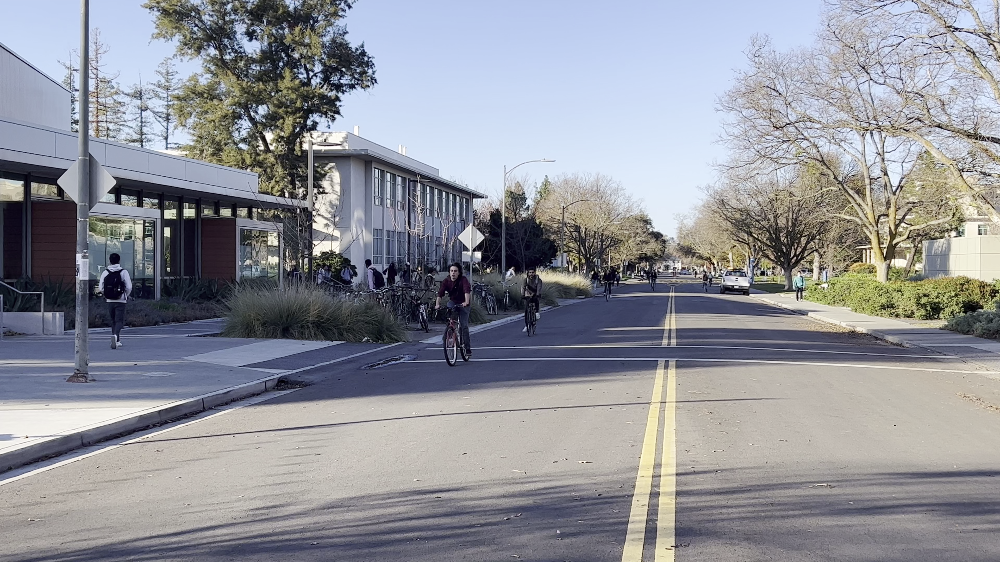

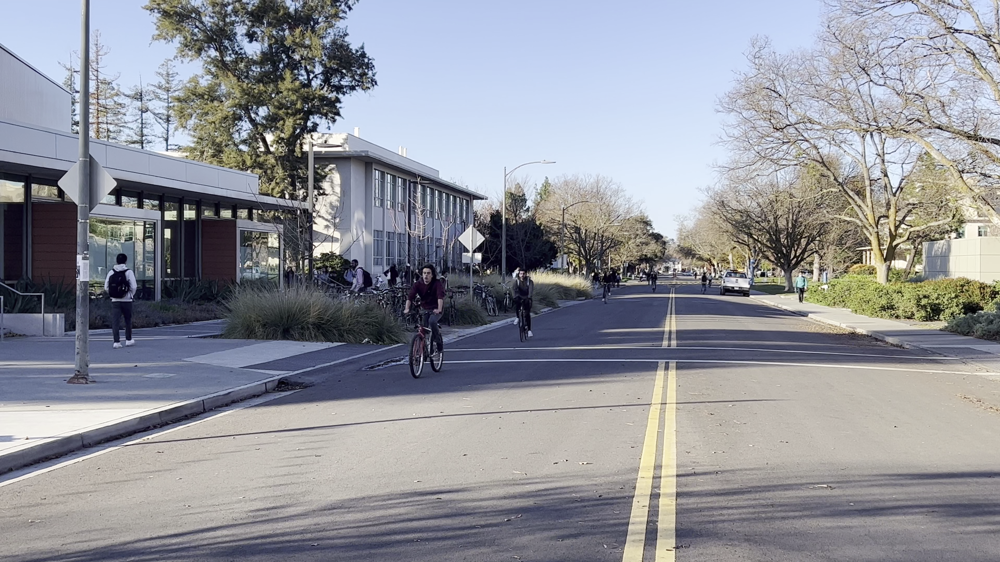

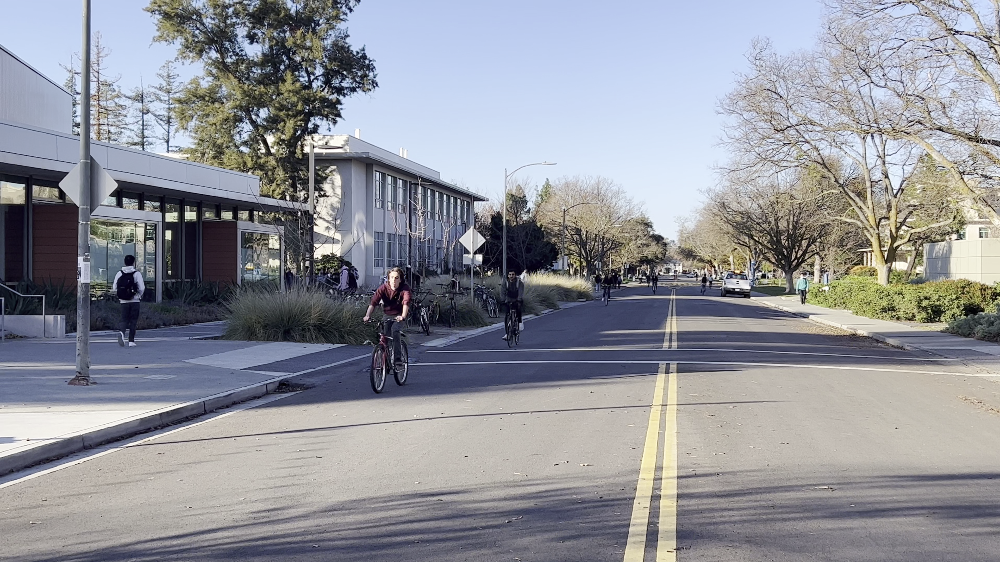

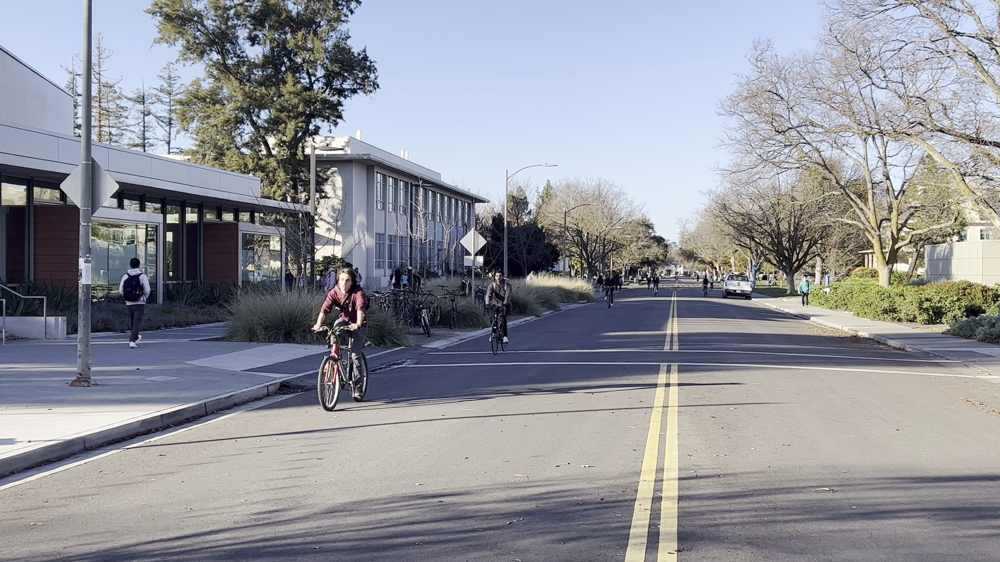

Buffered data was truncated after reaching the output size limit.

In [4]:
import time
from PIL import Image as save
import math 
import cv2
import os
from google.colab.patches import cv2_imshow


timer = 0
fps = 0.1
# Initialize Video capture Object.
# If you’re using a usb cam then this value can be 1, 2 etc  instead of 0
# cap = cv2.VideoCapture(0)

# Reading video from disk
cap = cv2.VideoCapture('/content/bicylist_vid2.mp4')

# This is how we define our codec
fourcc = cv2.VideoWriter_fourcc(*'XVID');

# Save our video at 10.0 FPS with the defined dimensions, Note my default camera
out = cv2.VideoWriter('output.avi', fourcc, fps, (640, 350))

iter = 0
rois = []


path = "/content/imgs"

# Initialize a loop in which we will read video frame by frame    
while (iter <= 1000):
    # Read frame by frame
    ret, frame = cap.read() 

    # If a frame is not read correctly exit the loop, most useful when working with videos on disk
    if not ret:
        break
        
    # Now we can perform any image processing operations.
    #frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    #frame = cv2.rotate(frame, cv2.ROTATE_90_COUNTERCLOCKWISE) # want clockwaise because we want the video to go down the flower beds (it goes right now)

    # Show the frame we just read
    #cv2_imshow(frame)

    box = np.array(frame)
    #x_bound = math.floor(box.shape[0] * 0.25)
    #box = box[0:x_bound, :, :]
    #gray_area = cv2.cvtColor(box,  cv2.COLOR_BGR2GRAY)
    #rect = cv2.rectangle(frame, (0,0), (gray_area.shape[1], x_bound), (204, 0, 0), 4) # why switch the 2? 
    #cv2_imshow(gray_area)
    #cv2_imshow(rect)
    #roi = box[:, 0:box.shape[1]] #height, width 0:x

    # save image file
    if (iter%10 == 1):
      cv2.imwrite(os.path.join(path, f'{iter}.png'), box) # saves the file to the user-designated path
      rois.append(box)
      cv2_imshow(box)

    # Save Video
    #out.write(gray)
        
    # Wait for the 1 millisecond, before showing the next frame.
    #  If the user presses the `q` key then exit the loop.
    #if cv2.waitKey(1)  ==  ord('q'):
    #    break
    iter += 1

# Release video writer
out.release()

# Release the camera
cap.release()

# Destroy the windows you created
cv2.destroyAllWindows()

In [ ]:
from google.colab import files
!zip -r /content/imgs.zip /content/imgs

In [8]:
files.download("/content/imgs.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>